# **Detection with Optical Flow**

In this notebook we will explore a simple method of moving object detection via Farneback Optical Flow. Optical Flow is a method of computing the motion of image intensities. The Farneback method allows us to compute the motion of all pixels in an image, the fact that it computes the flow for all pixels makes it a Dense Optical Flow method.

In this tutorial we only use Optical Flow to detect the object, but we could extend this and use the predicted motion of the pixels to help track the moving objects.

In [4]:
import os
from glob import glob
import re
import numpy as np
import cv2
import matplotlib.pyplot as plt
%matplotlib inline

### Visualize the data

We are using highway traffic scene data. The camera does not move and the cars are all moving, both of which make it ideal to obtain the background. 

Helper function to visualize images in sequence

In [5]:
# get properly sorted images
data_path = r'C:\Users\itber\Documents\datasets\nvidia'
image_paths = sorted(glob(f"{data_path}/*.jpg"), key=lambda x:float(re.findall("(\d+)",x)[0]))

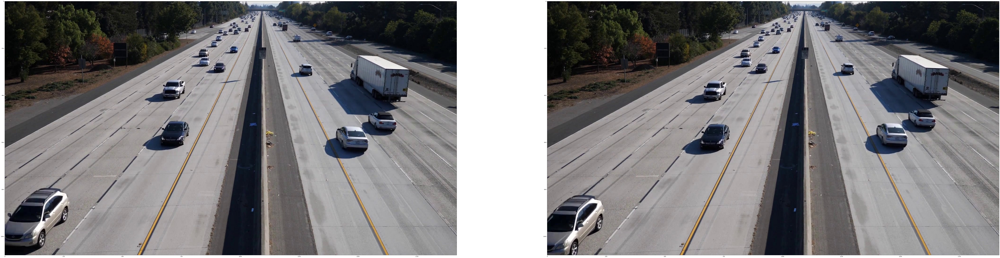

In [6]:
idx = 56

frame1_bgr = cv2.imread(image_paths[idx])
frame2_bgr = cv2.imread(image_paths[idx+1])

fig, ax = plt.subplots(1, 2, figsize=(150, 75))
ax[0].imshow(cv2.cvtColor(frame1_bgr, cv2.COLOR_BGR2RGB))
ax[1].imshow(cv2.cvtColor(frame2_bgr, cv2.COLOR_BGR2RGB));

### Compute the Farneback Optical Flow between two consecutive frames

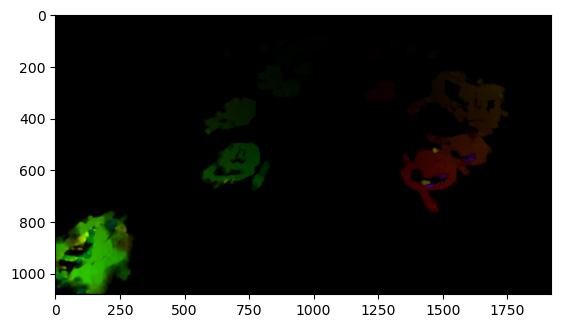

In [7]:
prev = cv2.cvtColor(frame1_bgr, cv2.COLOR_BGR2GRAY)
next = cv2.cvtColor(frame2_bgr, cv2.COLOR_BGR2GRAY)

hsv = np.zeros_like(frame1_bgr)
hsv[..., 1] = 255

# compute optical flow
# flow = cv2.calcOpticalFlowFarneback(prev, next, None, 
#             pyr_scale=0.5, # pyramid scale factor
#             levels=1, # number of pyramid layers
#             winsize=7, # averaging window
#             iterations=1, # iterations at each pyramid level
#             poly_n=5, # size of the neighborhood to find polynomial expansion
#             poly_sigma=1.5, # std dev of Gaussian used to smooth derivatives
#             flags=0)

flow = cv2.calcOpticalFlowFarneback(prev, next, None, 
            pyr_scale=0.5, # pyramid scale factor
            levels=3, # number of pyramid layers
            winsize=25, # averaging window
            iterations=3, # iterations at each pyramid level
            poly_n=5, # size of the neighborhood to find polynomial expansion
            poly_sigma=1.5, # std dev of Gaussian used to smooth derivatives
            flags=cv2.OPTFLOW_FARNEBACK_GAUSSIAN)


# format for display
mag, ang = cv2.cartToPolar(flow[..., 0], flow[..., 1])
hsv[..., 0] = ang*180/np.pi/2
hsv[..., 2] = cv2.normalize(mag, None, 0, 255, cv2.NORM_MINMAX)
bgr = cv2.cvtColor(hsv, cv2.COLOR_HSV2BGR)

# use a scale factor to visualize everything
plt.imshow(bgr);

#### Use the Optical Flow to get an Image Mask for Detections

In [8]:
def get_flow(prev, next):
    """ Obtains optical flow between 2 frames
        Inputs:
            prev - grayscale frame at t
            next - grayscale frame at t + 1
        Returns:
            mag - magnitude of flowmap
            ang - angle of flowmap (0, 2*pi)
        """
    hsv = np.zeros_like(frame1_bgr)
    hsv[..., 1] = 255


    flow = cv2.calcOpticalFlowFarneback(prev, next, None, 
                pyr_scale=0.5, # pyramid scale factor
                levels=3, # number of pyramid layers
                winsize=25, # averaging window
                iterations=3, # iterations at each pyramid level
                poly_n=5, # size of the neighborhood to find polynomial expansion
                poly_sigma=1.5, # std dev of Gaussian used to smooth derivatives
                flags=cv2.OPTFLOW_FARNEBACK_GAUSSIAN)


    # format for display
    mag, ang = cv2.cartToPolar(flow[..., 0], flow[..., 1])
    
    return mag, ang

In [9]:
def get_flow_viz(mag, ang):
    """ Obtains BGR image to Visualize the Optical Flow 
        """
    mag, ang = cv2.cartToPolar(flow[..., 0], flow[..., 1])
    hsv[..., 0] = ang*180/np.pi/2
    hsv[..., 2] = cv2.normalize(mag, None, 0, 255, cv2.NORM_MINMAX)
    bgr = cv2.cvtColor(hsv, cv2.COLOR_HSV2BGR)

    return bgr



In [10]:
def get_mask(mag):
    """ Obtains Detection Mask from Optical Flow Magnitude
        """
    mag_norm = cv2.normalize(mag, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)

    mag_norm = cv2.medianBlur(mag_norm, 3)

    mask = cv2.adaptiveThreshold(mag_norm, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,\
                cv2.THRESH_BINARY_INV, 23, 1)

    # morphological operations
    kernel = np.array((9,9), dtype=np.uint8)
    mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel, iterations=1)

    return mask

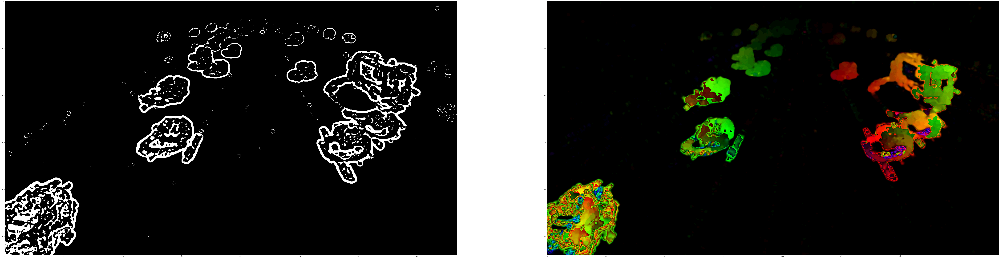

In [11]:
prev = cv2.cvtColor(frame1_bgr, cv2.COLOR_BGR2GRAY)
next = cv2.cvtColor(frame2_bgr, cv2.COLOR_BGR2GRAY)

# get optical flow
mag, ang = get_flow(prev, next)

# get optical flow visualization
bgr = get_flow_viz(mag, ang)

mask = get_mask(mag)
fig, ax = plt.subplots(1, 2, figsize=(150, 75))
ax[0].imshow(mask, cmap='gray')
ax[1].imshow(bgr*10);

Next we will find the contours on our image mask. These contours will help find the large moving objects that we wish to detect.

Then we will use the detected contours to find the moving objects. To do this we will use the "boundingRect" function to obtain bounding box locations of the detections. You may have noticed that the image mask was not perfectly denoised, instead of denoising the image mask we will use the area of each detected bounding box as a threshold to determine the initial detectons. 

In [12]:
def get_initial_detections(mask):
    """ Obtains initial proposed detections from the mask.
        Inputs:
            mask - thresholded image mask
        Outputs:
            detectons - list of proposed detection bounding boxes
        """
    # get mask contours
    contours, _ = cv2.findContours(mask, 
                               cv2.RETR_EXTERNAL, # cv2.RETR_TREE, 
                               cv2.CHAIN_APPROX_TC89_L1)

    detections = []
    for cnt in contours:
        x,y,w,h = cv2.boundingRect(cnt)
        area = w*h
        if area > 500: # hyperparameter
            detections.append([x,y,x+w,y+h])

    return detections

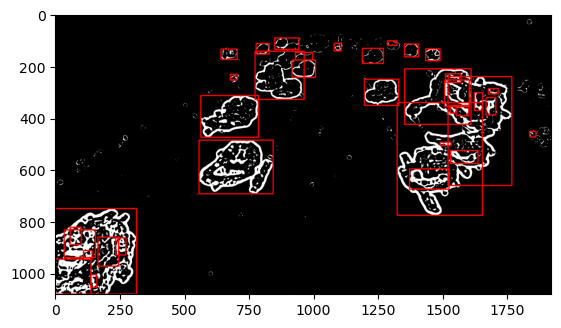

In [13]:
mask_rgb = cv2.cvtColor(mask, cv2.COLOR_GRAY2RGB)
detections = get_initial_detections(mask)

for det in detections:
    x1,y1,x2,y2 = det
    cv2.rectangle(mask_rgb, (x1,y1), (x2,y2), (255,0,0), 3)

plt.imshow(mask_rgb);

Next we need to perform non-maximal supression. First we will need a method of computing the Intersection over Union (IOU). We will write functions for this and display the interesected areas on our RGB mask

In [14]:
def compute_iou(box1, box2):
    """ Obtains Intersection over union (IOU) of 2 bounding boxes
        Inputs are in the form of:
            xmin, ymin, xmax, ymax = box
        """
    x11, y11, x21, y21 = box1
    x12, y12, x22, y22 = box2

    # get box points of intersection
    xi1 = max(x11, x12) # top left
    yi1 = max(y11, y12)
    xi2 = min(x21, x22) # bottom right
    yi2 = min(y21, y22)

    # compute intersectional area
    inter_area = max((xi2 - xi1 + 1), 0) * max((yi2 - yi1 + 1), 0)
    if inter_area == 0:
        return inter_area

    # compute box areas
    box1_area = (x21 - x11 + 1) * (y21 - y11 + 1)
    box2_area = (x22 - x12 + 1) * (y22 - y12 + 1)

    # return iou
    return inter_area / (box1_area + box2_area - inter_area)


In [15]:
def get_inter_area(box1, box2):
    """
    Obtains bounding box for intersection area of two boundning boxes
    Inputs are in the form of:
            xmin, ymin, xmax, ymax = box
    """
    x11, y11, x21, y21 = box1
    x12, y12, x22, y22 = box2

    # get box points of intersection
    xi1 = max(x11, x12) # top left
    yi1 = max(y11, y12)
    xi2 = min(x21, x22) # bottom right
    yi2 = min(y21, y22)

    # compute intersectional area
    inter_area = max((xi2 - xi1 + 1), 0) * max((yi2 - yi1 + 1), 0)
    if inter_area == 0:
        return 0, 0, 0, 0
        
    return xi1, yi1, xi2, yi2

In [16]:
mask_rgb_iou = mask_rgb.copy()

# only compare unique cases
idx_1, idx_2 = np.triu_indices(len(detections), k=1)

for i in range(len(idx_1)):
    d1 = detections[idx_1[i]]
    d2 = detections[idx_2[i]]
    iou = compute_iou(d1, d2)
    if iou > 0:
        # print(idx, np.round(iou,2))

        # draw intersection
        x1, y1, x2, y2 = get_inter_area(d1, d2)
        cv2.rectangle(mask_rgb_iou, (x1,y1), (x2,y2), (0,255,0), 3)

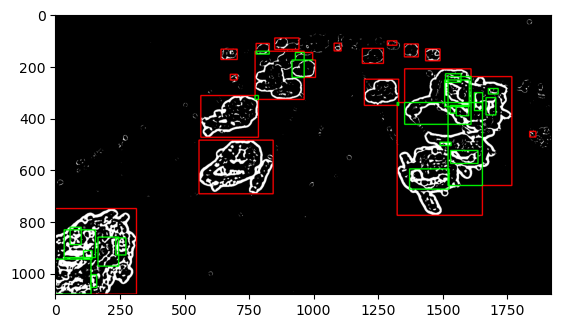

In [17]:
plt.imshow(mask_rgb_iou)

Now that we have computed the iou and obtained all of the overlapping bounding boxes, we need to remove the non-maximal bounding boxes. We will take a very simple approach to non-maximal supression, if the bounding box overlap exceeds a certain threshold, then we will remove the box with the smaller area. Let's code this into a single function.

First we will need to find each proposed bounding box and determine if anything overlaps with it. Then we will need to determine which proposed bounding box is the true bounding box.

In [18]:
def get_iou_indexes(detections, thresh=0):
    """ Get index locations of where each box has an IOU with
        another box that exceeds the threshold
        """
    # only compare unique cases
    idx_1, idx_2 = np.triu_indices(len(detections), k=1)

    iou_indexes = np.empty(idx_1.shape)

    idx = 0
    for i in range(len(idx_1)):
        d1 = detections[idx_1[i]]
        d2 = detections[idx_2[i]]

        # compare idx_1 to idx_2 if any from idx_2 has iou with idx_1, then we 
        # store the index of idx_2 as an iou of idx_2
        iou = compute_iou(d1, d2)
        if iou > thresh:
            iou_indexes[i] = idx_2[i]
        else:
            iou_indexes[i] = np.nan

    return iou_indexes

In [19]:
iou_indexes = get_iou_indexes(detections, thresh=1e-3)

In [20]:
def get_proposals(iou_indexes, idx_1, det):
    proposals = iou_indexes[idx_1 == det]
    return proposals[~np.isnan(proposals)]

In [21]:
def bbox_nms(detections, thresh=1e-6):
    """ Performs Non-Maximal Supression on detected bounding boxes.
        """
    nms_detections = []

    # get IOU indexes
    iou_indexes = get_iou_indexes(detections, thresh)

    # only compare unique cases
    idx_1, _ = np.triu_indices(len(detections), k=1)

    for d, det in enumerate(detections):
        # gather the largest of all the proposals
        proposal_idxs = get_proposals(iou_indexes, idx_1, d)

        # determine which box is the largest of all the proposals
        proposals = [det]
        areas = [(det[2] - det[0]) * (det[3] - det[1])]
        for p_idx in proposal_idxs:
            p_det = detections[int(p_idx)]
            areas.append((p_det[2] - p_det[0]) * (p_det[3] - p_det[1]))
            proposals.append(p_det)

        
        # append the largest box to the nms detections
        nms_det = proposals[np.argmax(areas)]
        if nms_det not in nms_detections:
            nms_detections.append(nms_det)


    return nms_detections

In [22]:
nms_detections = bbox_nms(detections, thresh=1e-3)
len(detections), len(nms_detections)

(37, 18)

Now we will draw our final detections on the image

In [23]:
mask_rgb_detections = cv2.cvtColor(mask, cv2.COLOR_GRAY2RGB)
for det in nms_detections:
    x1, y1, x2, y2 = det
    cv2.rectangle(mask_rgb_detections, (x1,y1), (x2,y2), (255,0,0), 3)

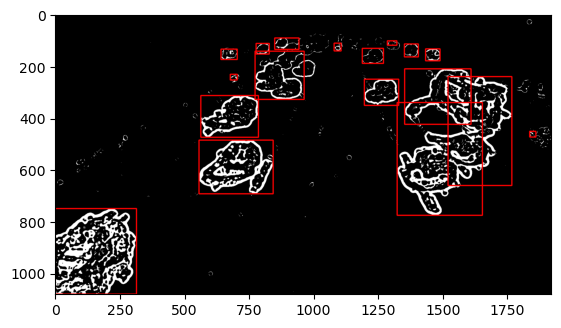

In [24]:
plt.imshow(mask_rgb_detections)

Now that we have our method, we can place everything together

In [25]:
def get_detections(frame1, frame2, nms_thresh=1e-3):
    """ Main function to get detections via Frame Differencing
        Inputs:
            frame1 - Grayscale frame at time t
            frame2 - Grayscale frame at time t + 1
            nms_thresh - IOU threshold for computing Non-Maximal Supression
        Outputs:
            detections - list with bounding box locations of all detections
                bounding boxes are in the form of: (xmin, ymin, xmax, ymax)
        """
    # get optical flow
    mag, _ = get_flow(frame1, frame2)

    # get image mask for moving pixels
    mask = get_mask(mag)

    # get initially proposed detections
    detections = get_initial_detections(mask)

    # perform Non-Maximal Supression on initial detections
    return bbox_nms(detections, nms_thresh)
    

Test the main pipeline and draw the detections on frame 2

In [26]:
def draw_bboxes(frame, detections):
    for det in detections:
        x1,y1,x2,y2 = det
        cv2.rectangle(frame, (x1,y1), (x2,y2), (0,255,0), 3)

In [29]:
video_frames = []

for idx in range(1, len(image_paths)):
    # read frames
    frame1_bgr = cv2.imread(image_paths[idx - 1])
    frame2_bgr = cv2.imread(image_paths[idx])

    # get detections
    detections = get_detections(cv2.cvtColor(frame1_bgr, cv2.COLOR_BGR2GRAY), 
                                cv2.cvtColor(frame2_bgr, cv2.COLOR_BGR2GRAY), 
                                nms_thresh=1e-3)
                                
    # draw bounding boxes on frame
    draw_bboxes(frame2_bgr, detections)

    # append to list for video
    video_frames.append(frame2_bgr)

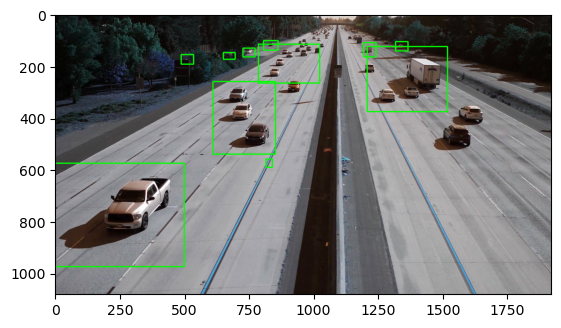

In [28]:
plt.imshow(frame2_bgr)

In [221]:
out = cv2.VideoWriter('farneback_optical_flow.mp4', cv2.VideoWriter_fourcc(*'MP4V'), 25, (1920, 1080))

for img in video_frames:
    out.write(img)

out.release()